# Autoencoder for Image compression (lossy)
> An autoencoder if given by an identity function **f(x)=x**  this look like a simple function but can be decomposed into 2 functions  **g(x)=y  and f'(y)=x** these can be mixed together to form a composite function **f'(g(x))=x** here these function are equivalent **f(x) = f'(g(x)) = x**, so point to consider is if the value at **g(x)** is small so it will contain all the relevent feature of our **x**

# Download and Prepare Dataset
> We will be using the STL10 data set for training our model to learn the function **f'(g(x))=x** 


Now extract the zip file 
we create a folder all data using command **mkdir data**
then we will extract the data there

In [0]:
#create a folder where to extract data
!mkdir data


In [0]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torch.autograd import Variable
from torch.utils.data import DataLoader
import torchvision.datasets as dset
from torchvision.utils import save_image
import torchvision.utils as utils
from torchvision import transforms
from torchsummary import summary

import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline

In [0]:
dataroot = './data'
image_size = 128
channels = 3
num_epochs = 10
values ={
  'batch_size': 64,
  'num_workers' : 4,
  'shuffle' : True
}
learning_rate = 1e-3
weight_decay = 1e-5

In [0]:
def to_image(x):
  x = 0.5*(x+1);
  x = x.clamp(0,1)
  x = x.view(x.size(0), channels, image_size, image_size)
  return x

In [4]:
# selecting the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [0]:
# define transform method
transform = transforms.Compose([
                               transforms.Resize((image_size,image_size)),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5))
])

download the data using torcvision.dataset.STL10


In [6]:
#load the data 
#data set will also be downloaded (approx 1.2gb)
dataset = dset.STL10(dataroot, split='train', transform=transform, download=True)

dataloader = DataLoader(dataset, **values)

Files already downloaded and verified


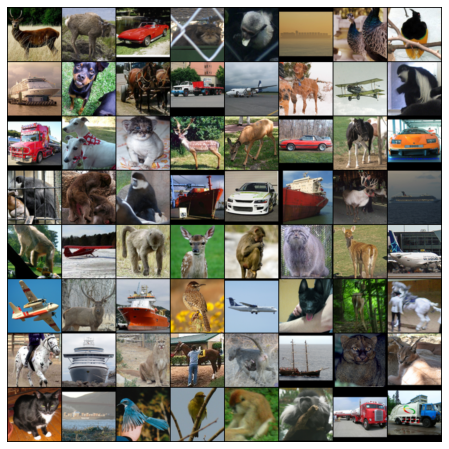

In [7]:
# view some image
batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.imshow(np.transpose(utils.make_grid(batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
#define the encoder
# encoder is  the function which act as g(x)=y
class Encoder(nn.Module):
  def __init__(self):
    super(Encoder, self).__init__()
    self.conv1 = nn.Conv2d(3, 6, 5)
    self.maxpool1 = nn.MaxPool2d(2, return_indices=True)
    self.tanh1 = nn.Tanh()
    self.conv2 = nn.Conv2d(6, 12, 5)
    self.maxpool2 = nn.MaxPool2d(2, return_indices=True)
    self.tanh2 = nn.Tanh()
    self.conv3 = nn.Conv2d(12,16, 5)
    self.tanh3 = nn.Tanh()

  def forward(self, x):
    indices=[]
    x = self.conv1(x)
    x , ind = self.maxpool1(x)
    indices.append(ind)
    x = self.tanh1(x)
    x = self.conv2(x)
    x , ind = self.maxpool2(x)
    indices.append(ind)
    x = self.tanh2(x)
    x = self.conv3(x)
    x = self.tanh3(x)
    return x,indices

In [0]:
#define the dencoder
# it act as f'(y)=x
class Decoder(nn.Module):
  def __init__(self):
    super(Decoder, self).__init__()
    self.convT3 = nn.ConvTranspose2d(16, 12, 5)
    self.tanh2 = nn.Tanh()
    self.maxunpool2 = nn.MaxUnpool2d(2)
    self.convT2 = nn.ConvTranspose2d(12 , 6, 5)
    self.tanh1 = nn.Tanh()
    self.maxunpool1 = nn.MaxUnpool2d(2)
    self.convT1 = nn.ConvTranspose2d(6,3,5)
    self.tanh0 = nn.Tanh()
  
  def forward(self, x,indices):
    x = self.convT3(x)
    x = self.tanh2(x)
    x = self.maxunpool2(x, indices[1])
    x = self.convT2(x)
    x = self.tanh1(x)
    x = self.maxunpool1(x, indices[0])
    x = self.convT1(x)
    x = self.tanh0(x)
    return x

In [0]:
# now combining g(x)=y and f'(y)=x to form f'(g(x))=x

class Autoencoder(nn.Module):
  def __init__(self):
    super(Autoencoder, self).__init__()
    self.encoder = Encoder()
    self.decoder = Decoder()
  
  def forward(self, x):
    x, indices = self.encoder(x)
    x = self.decoder(x, indices)
    return x

In [0]:
# define the error function 
class MSE_Loss(nn.Module):
  def __init__(self):
    super(MSE_Loss, self).__init__()
    self.lossr = nn.MSELoss(reduction='mean')
    self.lossg = nn.MSELoss(reduction='mean')
    self.lossb = nn.MSELoss(reduction='mean')
  
  def forward(self, x , y):
    # the format of tensor in pytorch is (batch_size, channels, height, width)
    # the error is the mean of the MSE of each channel
    # x is out input image and y is our target image
    r = self.lossr(x[:, 0:1, :, :], y[:, 0:1, :, :])
    g = self.lossg(x[:, 1:2, :, :], y[:, 1:2, :, :])
    b = self.lossb(x[:, 2: , :, :], y[:, 2: , :, :])
    mean = (r+g+b)/3
    return mean, (r,g,b)

In [12]:
model = Autoencoder().to(device)
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
# test if model is working correctly
x = torch.randn(1,3,128,128).to(device)
y = model(x)
model

Autoencoder(
  (encoder): Encoder(
    (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (maxpool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (tanh1): Tanh()
    (conv2): Conv2d(6, 12, kernel_size=(5, 5), stride=(1, 1))
    (maxpool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (tanh2): Tanh()
    (conv3): Conv2d(12, 16, kernel_size=(5, 5), stride=(1, 1))
    (tanh3): Tanh()
  )
  (decoder): Decoder(
    (convT3): ConvTranspose2d(16, 12, kernel_size=(5, 5), stride=(1, 1))
    (tanh2): Tanh()
    (maxunpool2): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2), padding=(0, 0))
    (convT2): ConvTranspose2d(12, 6, kernel_size=(5, 5), stride=(1, 1))
    (tanh1): Tanh()
    (maxunpool1): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2), padding=(0, 0))
    (convT1): ConvTranspose2d(6, 3, kernel_size=(5, 5), stride=(1, 1))
    (tanh0): Tanh()
  )
)

In [0]:
# create a loss/error class
loss_fn = MSE_Loss()

In [0]:
# define the training function
def train(dataloader, model, optimizer, loss_fn, num_epochs=1, show_image=False):
  itr=0
  model.train()
  for epoch in range(num_epochs):
    for img,_ in dataloader:
      img = Variable(img).to(device)
      
      # do a forward pass
      output = model(img)

      #get loss
      loss, ch_loss = loss_fn(output, img)    # loss is overall loss, ch_loss is loss in channels

      #backward pass
      optimizer.zero_grad()
      loss.backward()
      optimizer.step()

      if show_image and itr%50==0:
        print('iter [{}] , losses : {:.4f} , {:.4f}, {:.4f}, {:.4f}'.format(itr, loss.data.item(), ch_loss[0].data.item(), ch_loss[1].data.item(), ch_loss[2].data.item()))
        
        images = to_image(output.to('cpu').data)
        fig = plt.figure(figsize=(16,16))
        ax = plt.imshow(np.transpose(utils.make_grid(images.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)
        plt.show(fig)
      itr+=1
      
    print('epoch [{}/{}/ iter:{}], loss:{:.4f}'.format(epoch + 1, num_epochs, itr, loss.data.item()))


iter [0] , losses : 0.2982 , 0.3098, 0.2661, 0.3187


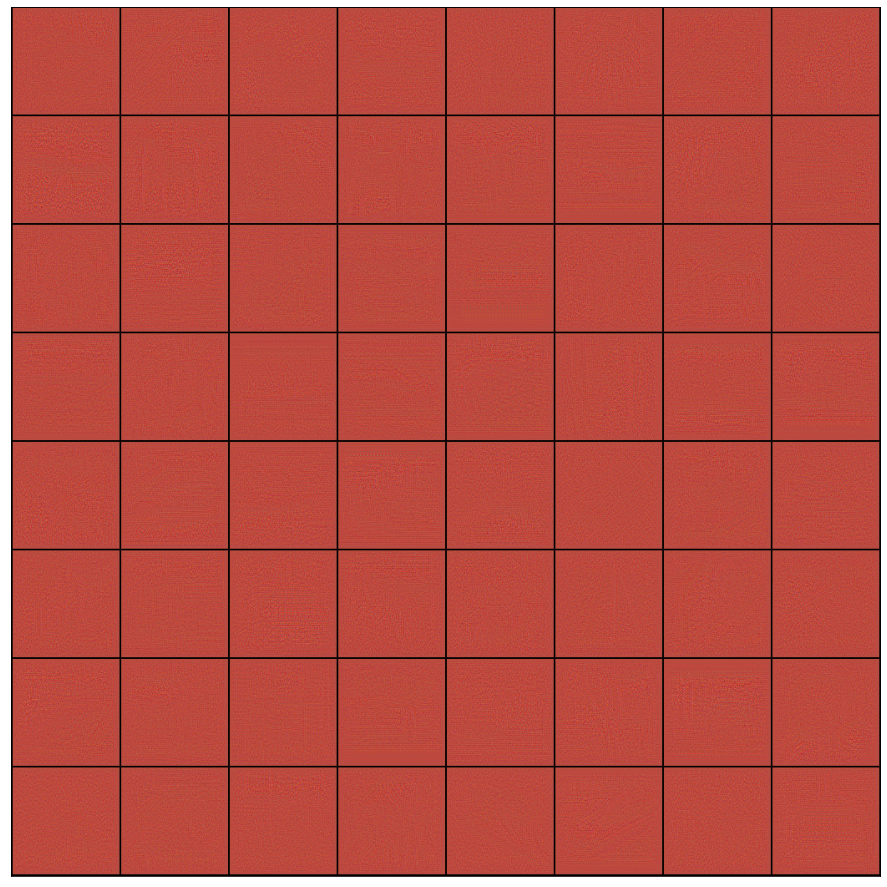

iter [50] , losses : 0.1071 , 0.1127, 0.0916, 0.1169


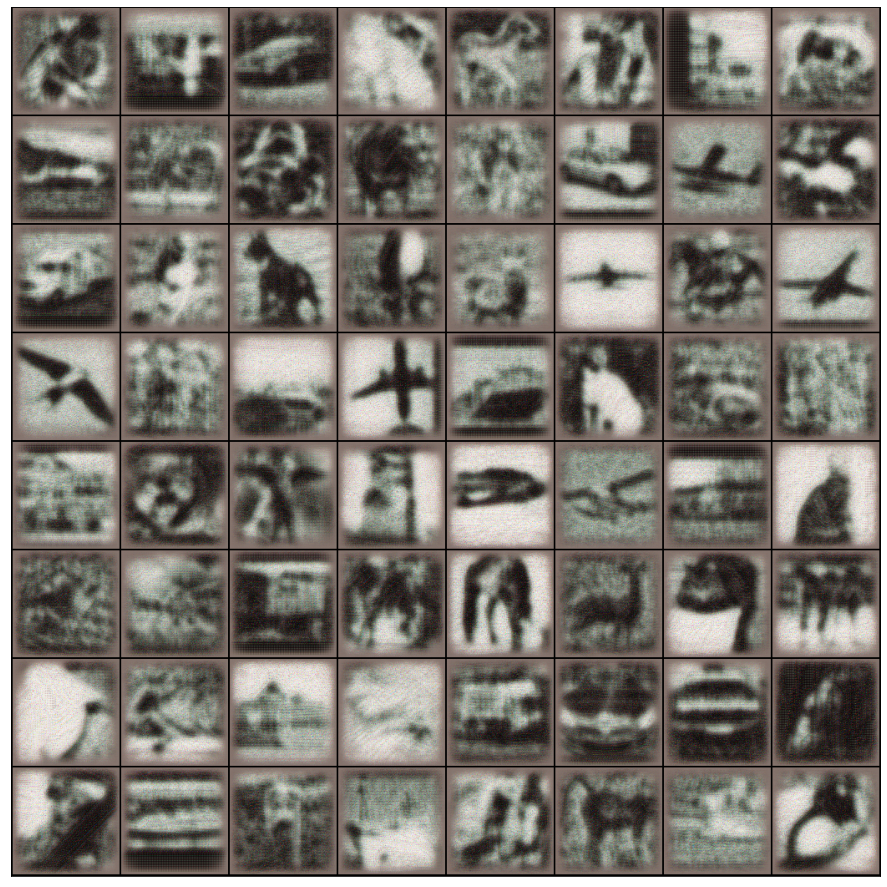

epoch [1/10/ iter:79], loss:0.0877
iter [100] , losses : 0.0719 , 0.0751, 0.0609, 0.0796


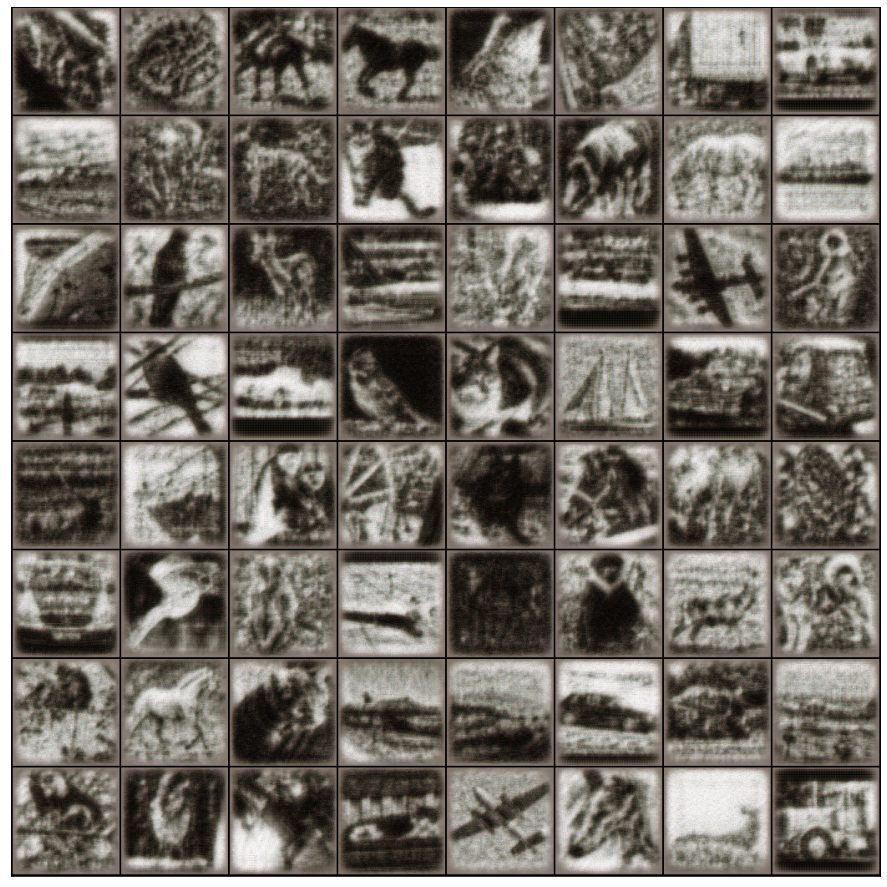

iter [150] , losses : 0.0670 , 0.0728, 0.0555, 0.0726


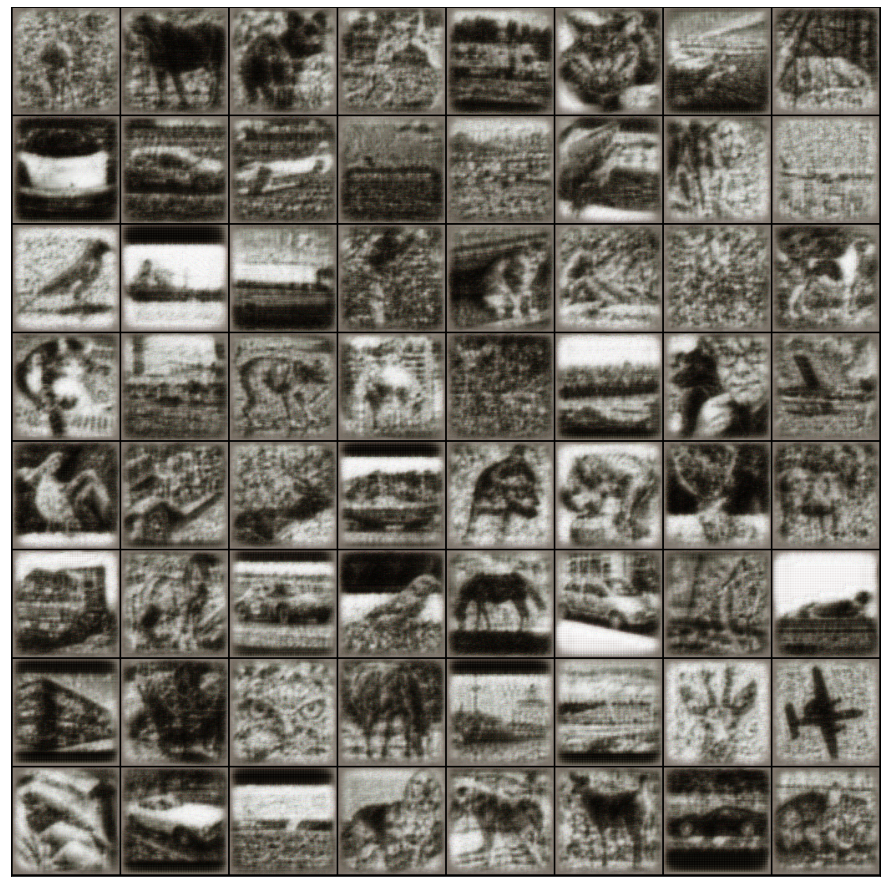

epoch [2/10/ iter:158], loss:0.0970
iter [200] , losses : 0.0641 , 0.0711, 0.0493, 0.0718


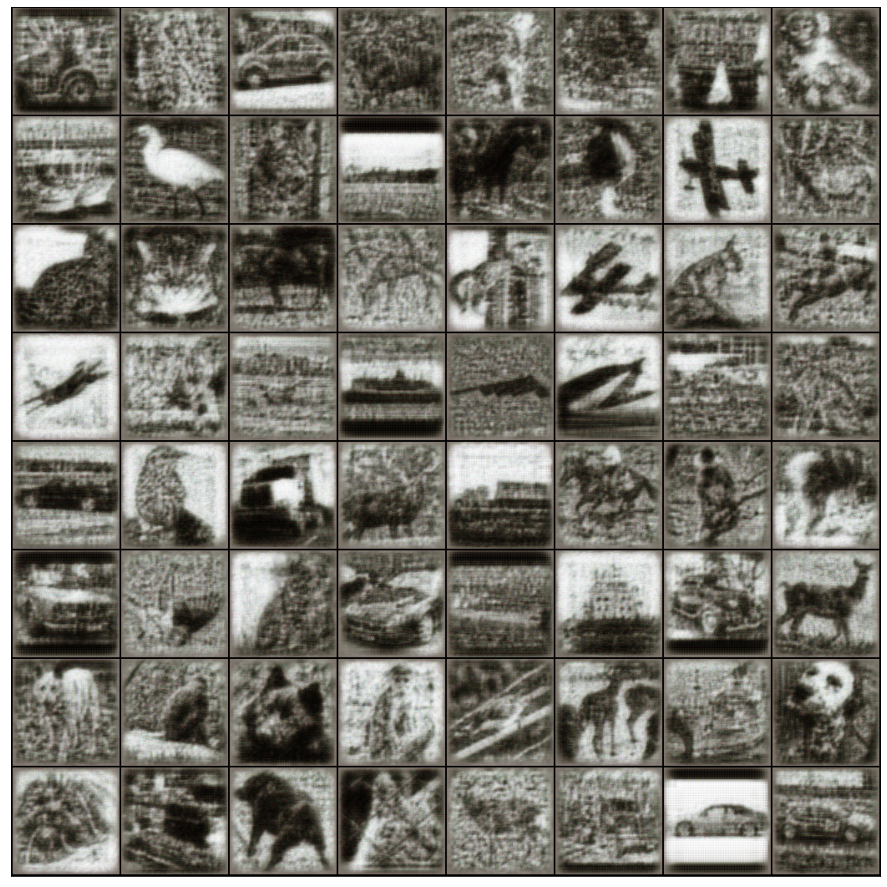

epoch [3/10/ iter:237], loss:0.0632
iter [250] , losses : 0.0690 , 0.0841, 0.0454, 0.0775


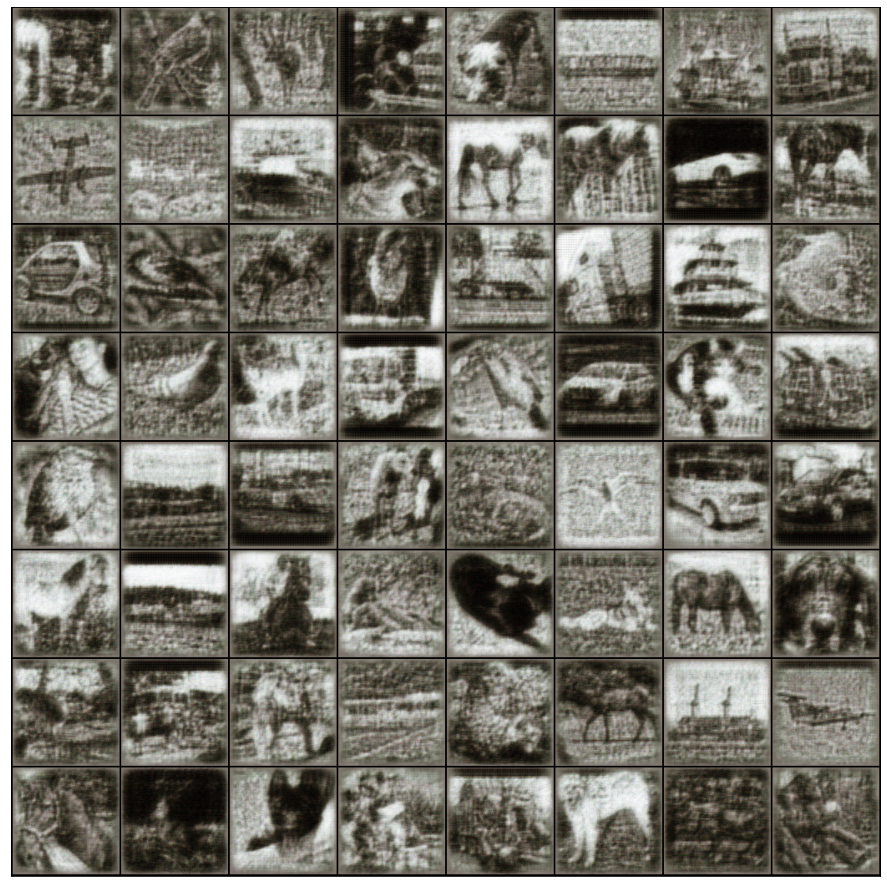

iter [300] , losses : 0.0594 , 0.0684, 0.0420, 0.0677


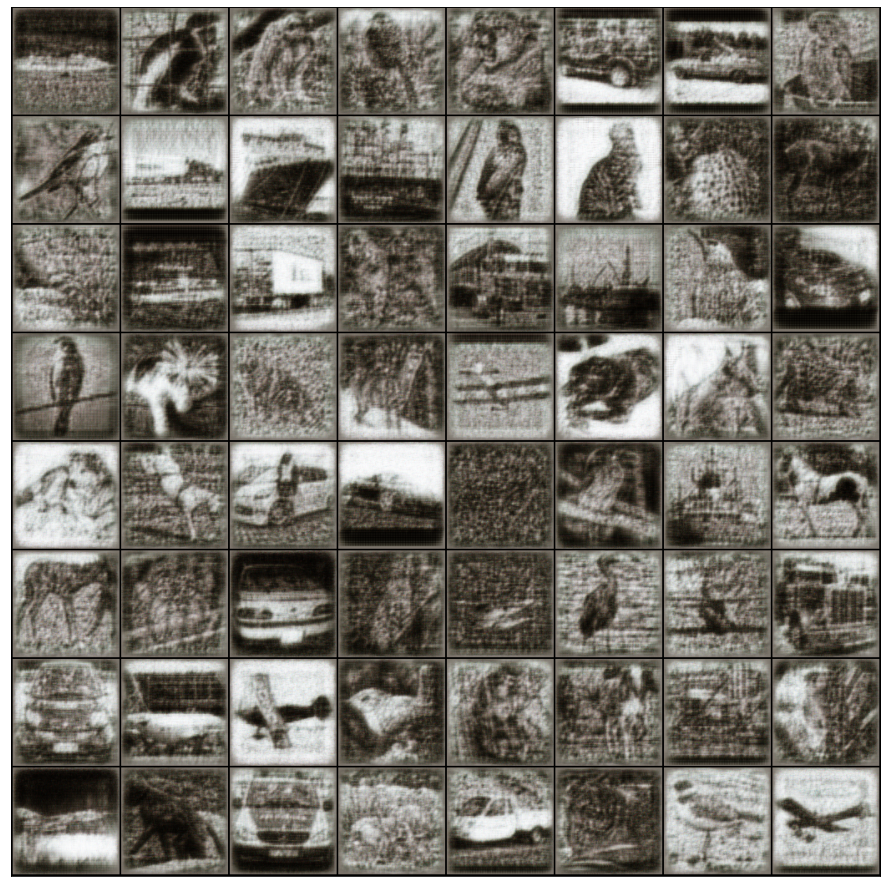

epoch [4/10/ iter:316], loss:0.0572
iter [350] , losses : 0.0602 , 0.0679, 0.0436, 0.0689


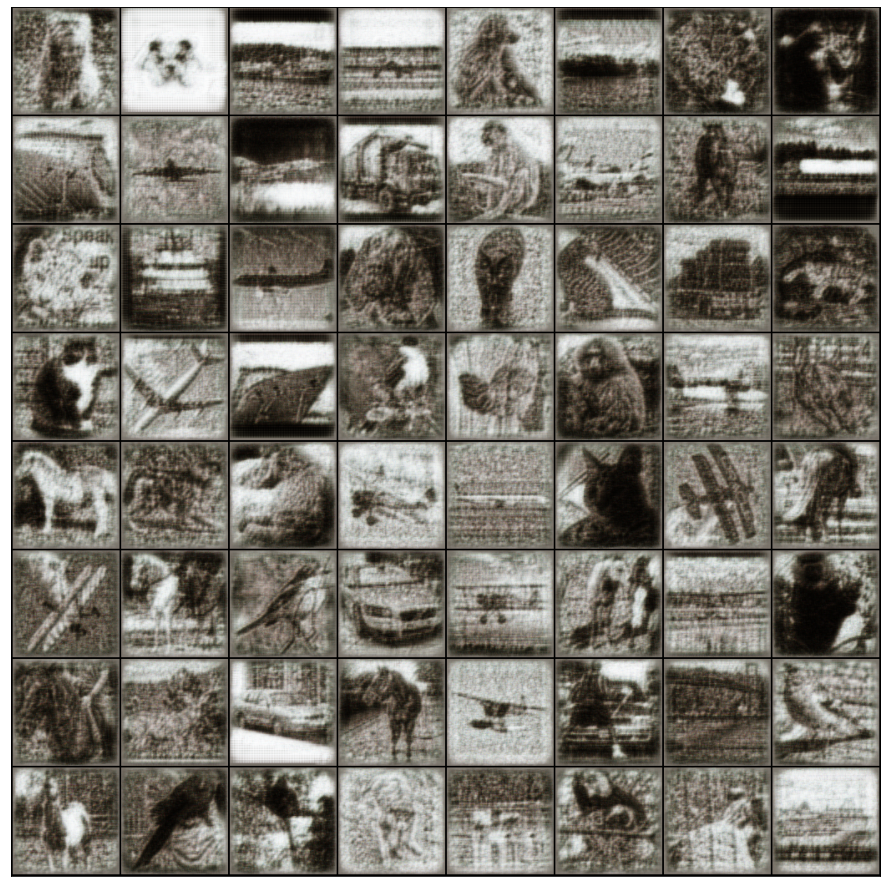

epoch [5/10/ iter:395], loss:0.0565
iter [400] , losses : 0.0548 , 0.0593, 0.0424, 0.0627


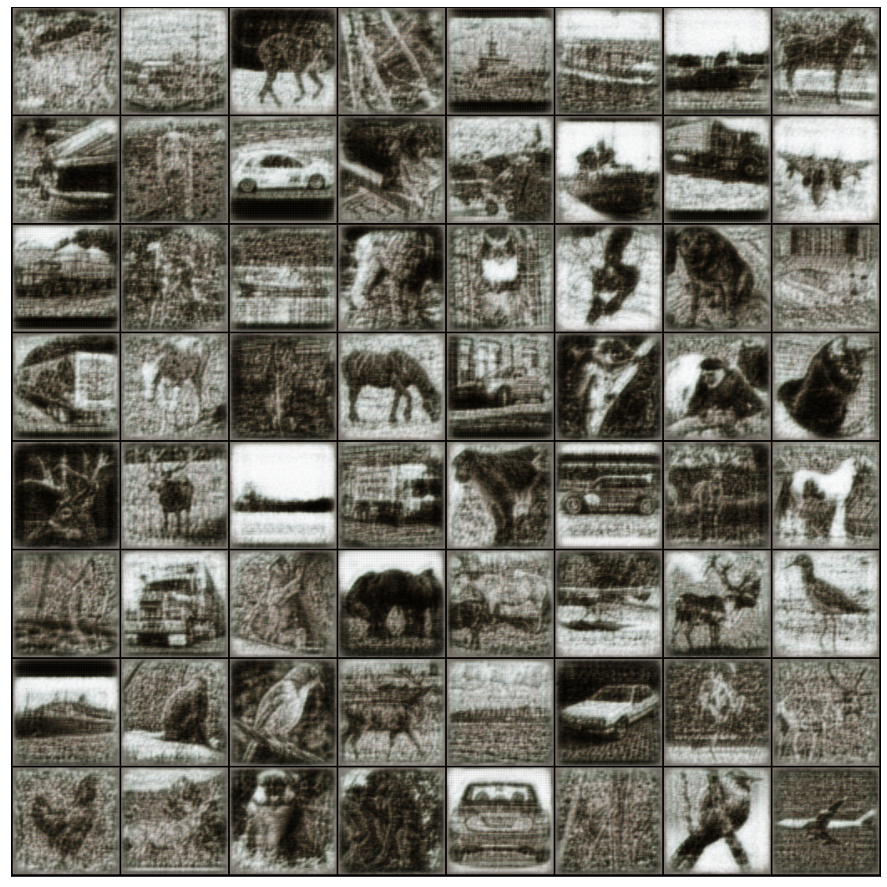

iter [450] , losses : 0.0563 , 0.0636, 0.0429, 0.0623


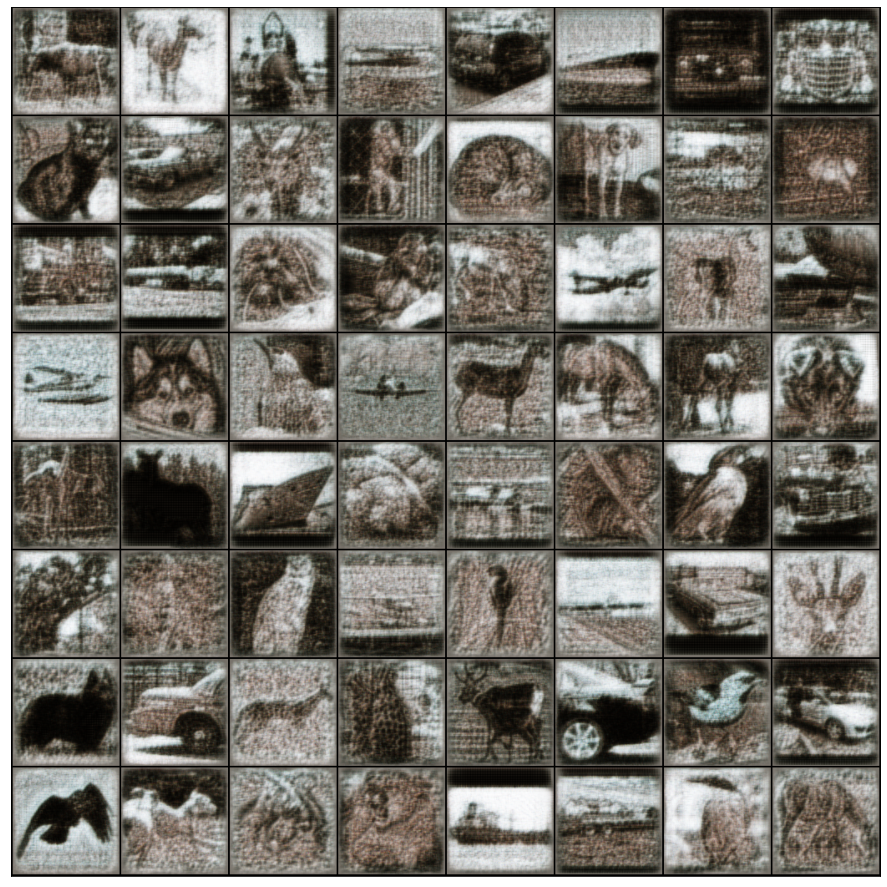

epoch [6/10/ iter:474], loss:0.0617
iter [500] , losses : 0.0458 , 0.0471, 0.0418, 0.0485


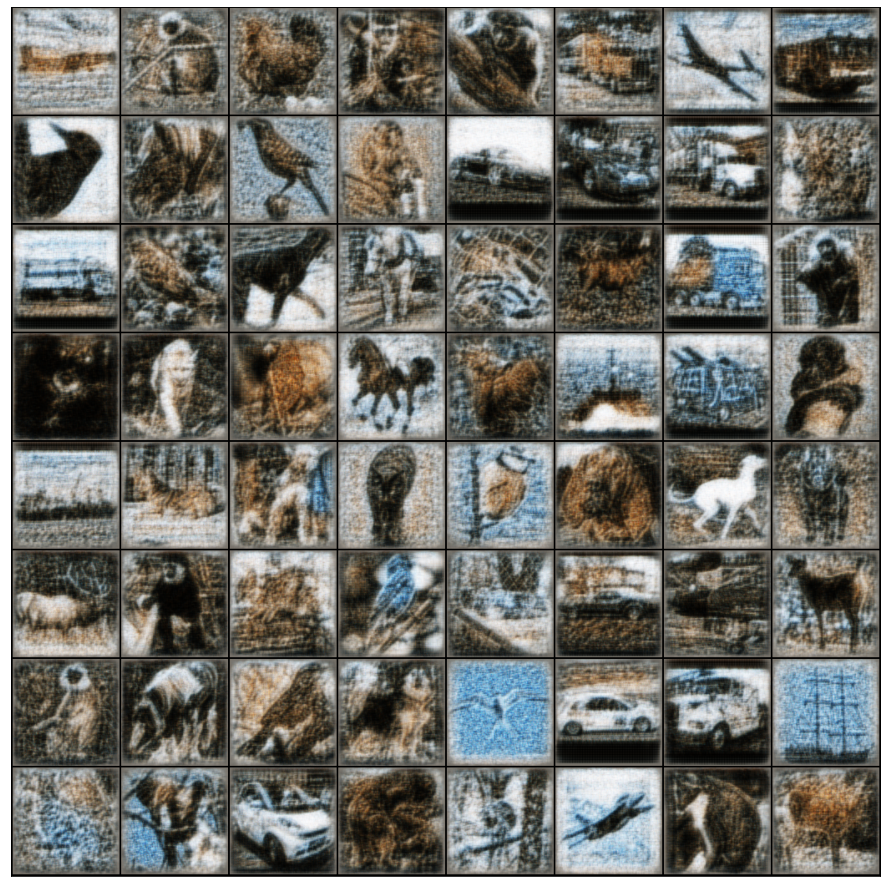

iter [550] , losses : 0.0458 , 0.0495, 0.0425, 0.0453


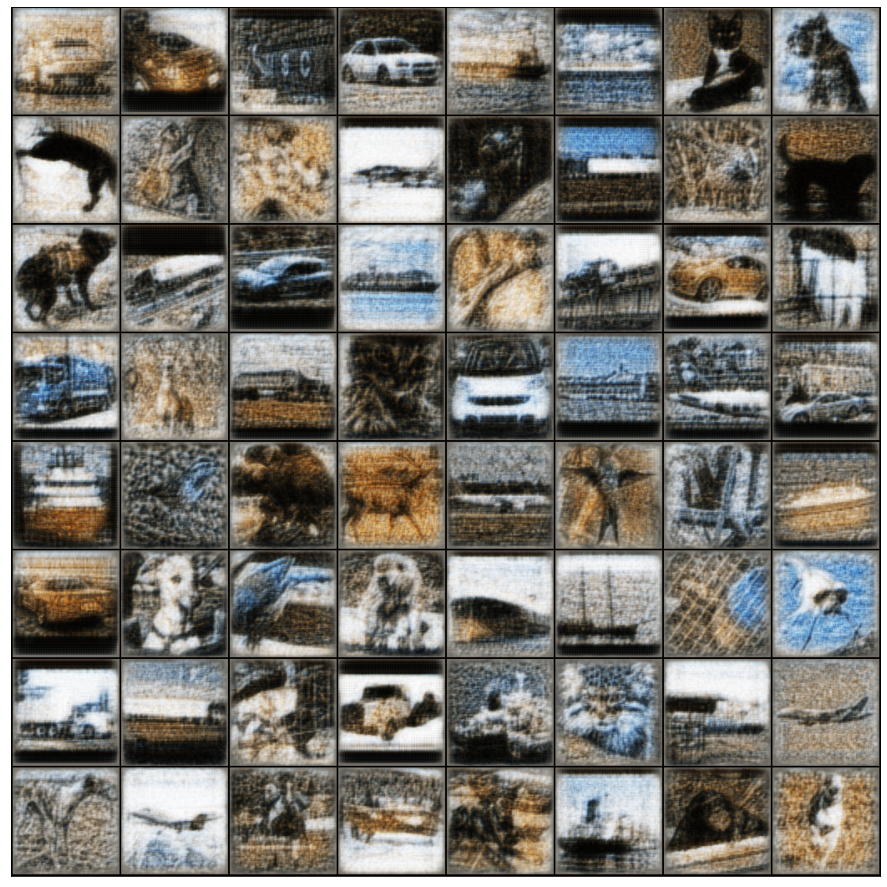

epoch [7/10/ iter:553], loss:0.0487
iter [600] , losses : 0.0443 , 0.0476, 0.0403, 0.0451


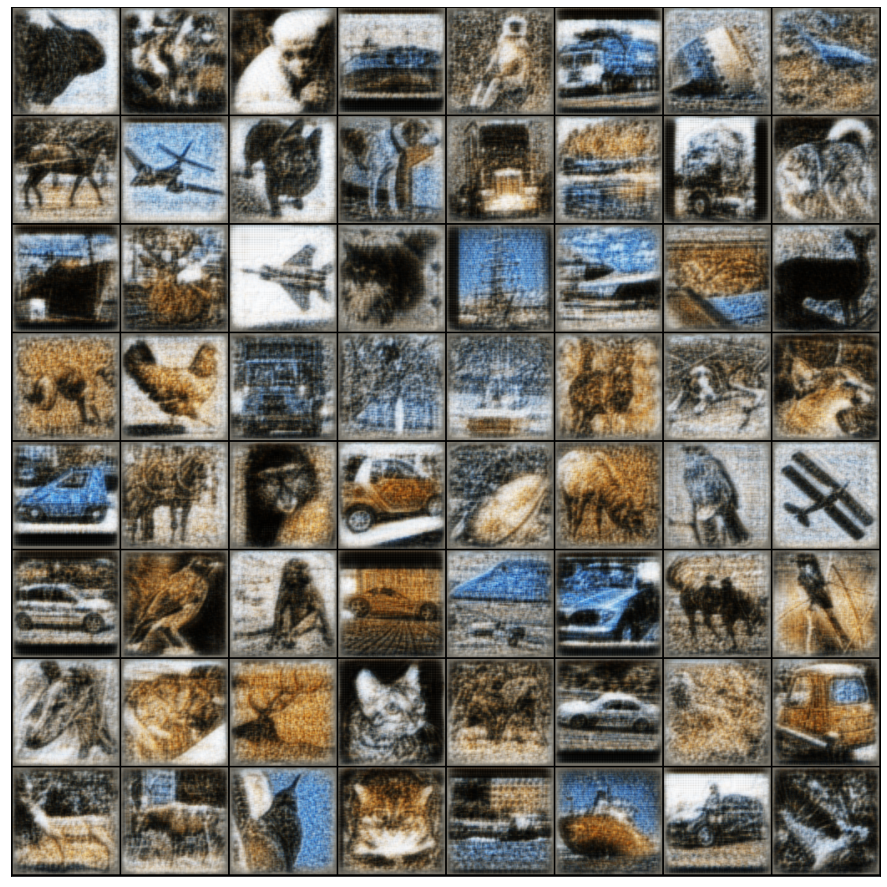

epoch [8/10/ iter:632], loss:0.0408
iter [650] , losses : 0.0447 , 0.0450, 0.0434, 0.0455


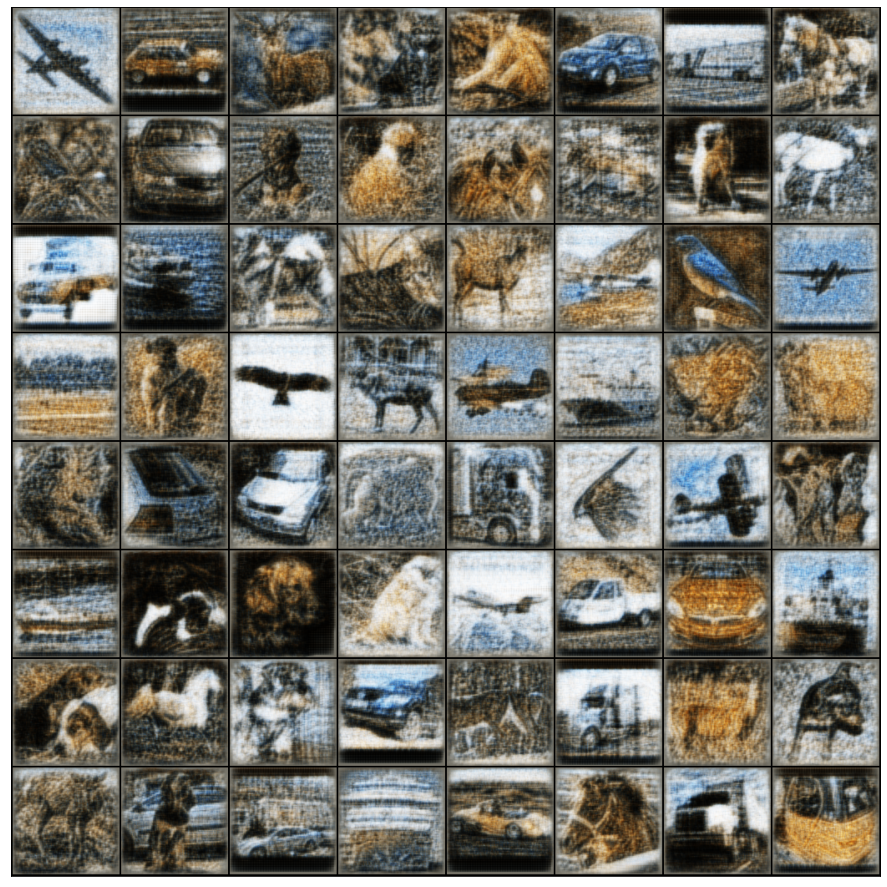

iter [700] , losses : 0.0431 , 0.0441, 0.0395, 0.0456


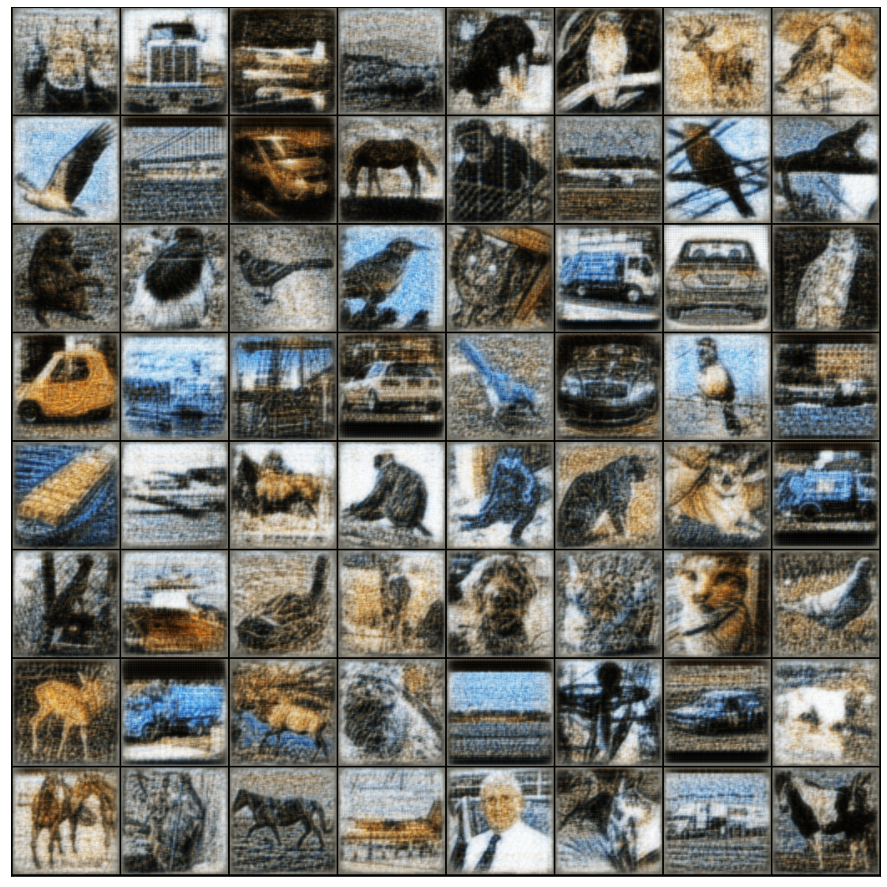

epoch [9/10/ iter:711], loss:0.0505
iter [750] , losses : 0.0393 , 0.0405, 0.0370, 0.0404


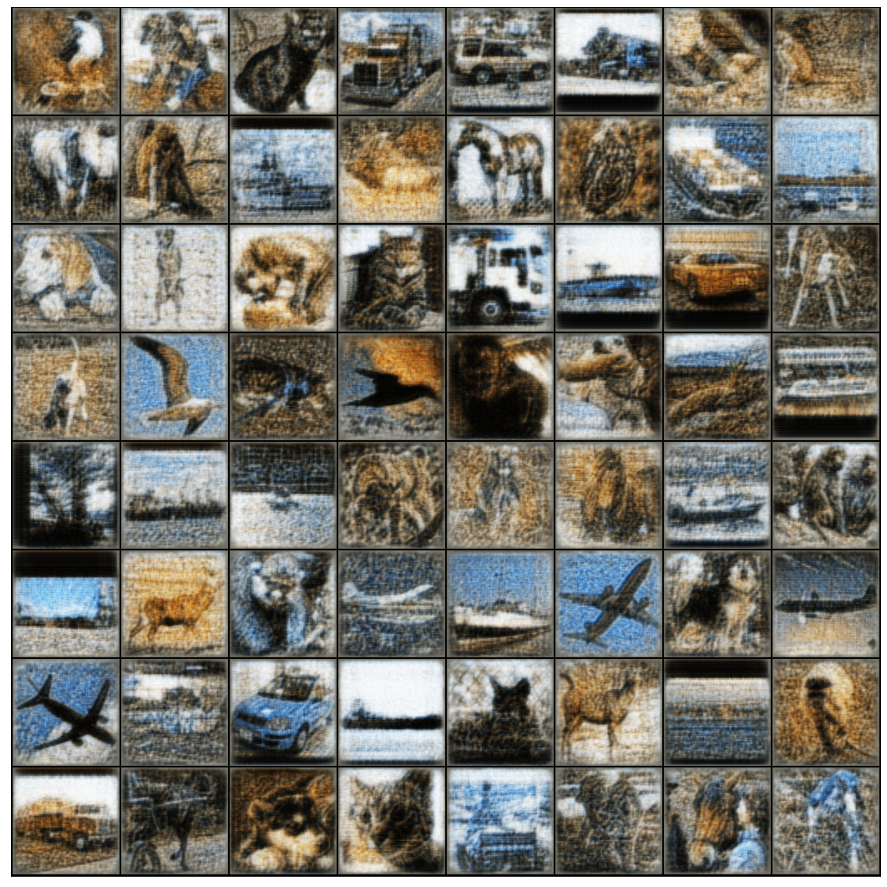

epoch [10/10/ iter:790], loss:0.0373


In [15]:
train(dataloader, model, optimizer, loss_fn, num_epochs = num_epochs, show_image=True)

In [0]:
#save the model
torch.save(model.state_dict(), './autoencoder_COCO_data.pth')

In [18]:
from google.colab import files
files.download('./autoencoder_COCO_data.pth')

MessageError: ignored